# DTSA 5511 Introduction to Machine Learning: Deep Learning

Week 5: Using GANs to Create Art - Monet

Andrew Simms (University of Colorado Boulder)  
2024-12-06

# 1. Problem Description

Generative Adversarial Networks (GANs) are a novel neural network
architecture designed for generating synthetic data. Unlike traditional
Convolutional Neural Networks (CNNs), which are designed for
classification or feature extraction, GANs operate using a dual-network
framework comprising a generator and a discriminator. The generator
creates artificial outputs, while the discriminator evaluates their
authenticity, driving iterative improvements in the generator’s output.
This project applies GANs to transform photographic images into works of
art inspired by Claude Monet, leveraging the distinctive style of an
influential Impressionist artist.

<figure id="fig-monet-nymph">
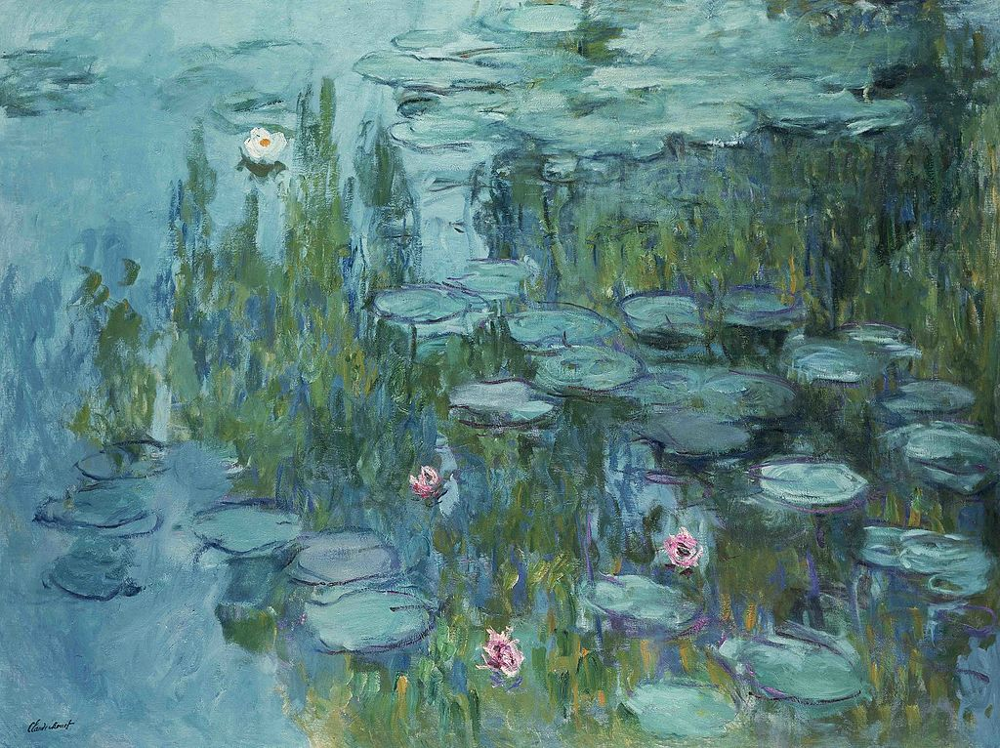
<figcaption>Figure 1: Water Lillies By Claude Monet circa 1915 from
<span class="citation" data-cites="wiki:monet_nymph">Wikimedia Commons
(2024)</span></figcaption>
</figure>

## 1.1 Kaggle Competition Specification

This projects creates a submission for the “I’m Something of a Painter
Myself” Kaggle competition by Jang, Uzsoy, and Culliton (2020). The
objective is to develop a GAN capable of generating Monet-style artworks
from photographs. Model performance is evaluated using the
Memorization-informed Fréchet Inception Distance (MiFID) metric Bai et
al. (2021), which measures both generation quality and style transfer
while preventing direct copying of training data.

## 1.2 GAN Architecture Overview

This projects GAN implementation, detailed in
<a href="#sec-model" class="quarto-xref">Section 4</a>, uses PyTorch
(Ansel et al. 2024) with architectural features optimized for style
transfer. The generator follows a multi-stage design: initial feature
extraction, downsampling through strided convolutions, nine residual
blocks (Szegedy et al. 2014) for style learning, and upsampling via
transposed convolutions, ending with a tanh-activated output layer. The
discriminator implements a PatchGAN (Isola et al. 2018) architecture,
evaluating image authenticity at the patch level through progressive
feature extraction.

## 1.3 Project Workflow

The research workflow, shown in
<a href="#fig-proj-work" class="quarto-xref">Figure 2</a>, begins with
Exploratory Data Analysis of the Monet and photographic image datasets.
Following data preprocessing and GAN architecture development, we
optimize the model by tuning learning rates, batch sizes, and
architectural parameters. Training progress is tracked using generator
loss, discriminator accuracy, and MiFID scores. The final model
selection combines validation metrics and qualitative assessment to
determine the best configuration for image generation.

<figure id="fig-proj-work">
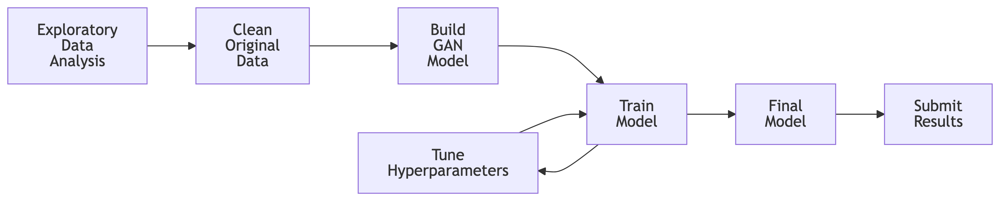
<figcaption>Figure 2: GAN Project Workflow</figcaption>
</figure>

# 2. Exploratory Data Analysis

## 2.1 Sample of Training Images

### 2.1.1 Monet Training Images

``` python
from pathlib import Path
import matplotlib.pyplot as plt
from PIL import Image

training_monet_path = Path("../data/monet_jpg/")
training_monet_images = sorted(list(training_monet_path.rglob("*.jpg")))
select_training_images = training_monet_images[:15]

def plot_images(img_paths, zoom=False, scale_factor=1):
    for this_img in img_paths:
        with Image.open(this_img) as img:
            if zoom:
                # Crop to the center 32x32 pixels
                width, height = img.size
                left = (width - 32) // 2
                top = (height - 32) // 2
                right = left + 32
                bottom = top + 32
                img = img.crop((left, top, right, bottom))

            # Get the new image size
            width, height = img.size

            # Apply scale factor if zoomed
            width *= scale_factor
            height *= scale_factor

            # Set figure size to match the scaled image size
            dpi = 100  # Dots per inch
            figsize = (width / dpi, height / dpi)

            # Create figure and axes
            fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
            ax.imshow(img)
            ax.axis("off")  # Turn off axes

            # Remove all margins and display inline
            plt.subplots_adjust(left=0, right=1, top=1, bottom=0)
            plt.show()

plot_images(select_training_images)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-1">
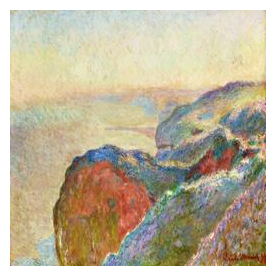
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-2">
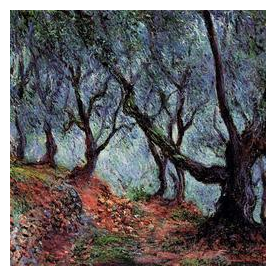
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-3">
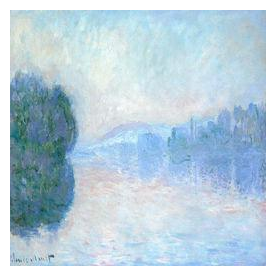
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-4">
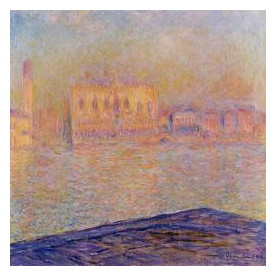
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-5">
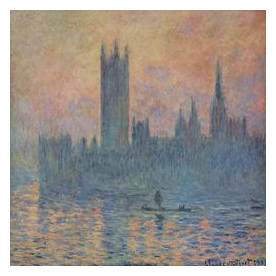
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-6">
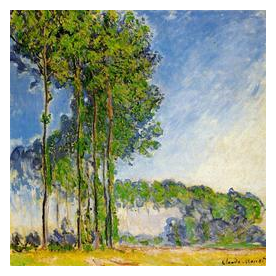
<figcaption>(f)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-7">
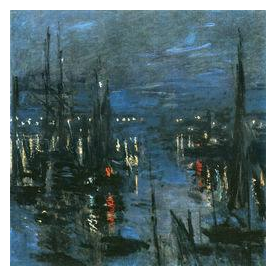
<figcaption>(g)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-8">
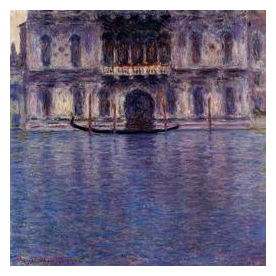
<figcaption>(h)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-9">
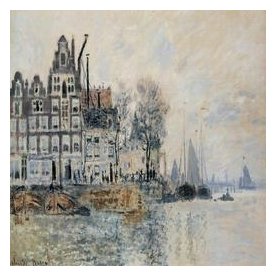
<figcaption>(i)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-10">
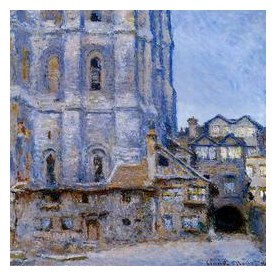
<figcaption>(j)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-11">
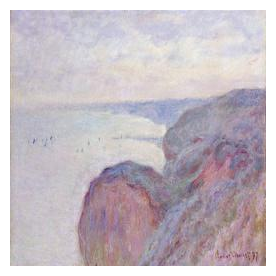
<figcaption>(k)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-12">
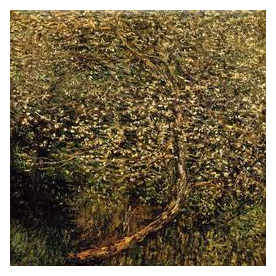
<figcaption>(l)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-13">
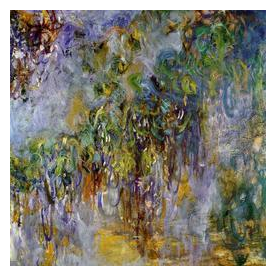
<figcaption>(m)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-14">
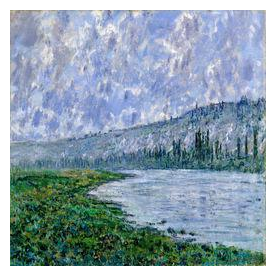
<figcaption>(n)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-15">
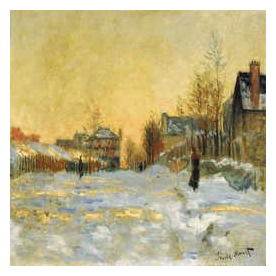
<figcaption>(o)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 3: Sample of Artist Training Images

In <a href="#fig-train-images-sample" class="quarto-xref">Figure 3</a>,
we see a selection of Monet’s paintings. While they all share a
distinctive style, there is noticeable variation in color palette,
subject matter, and mood across the images.

### 2.1.2 Photo Training Images

``` python
training_photo_path = Path("../data/photo_jpg/")
training_photo_images = sorted(list(training_photo_path.rglob("*.jpg")))
select_training_images = training_photo_images[:15]
plot_images(select_training_images)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-1">
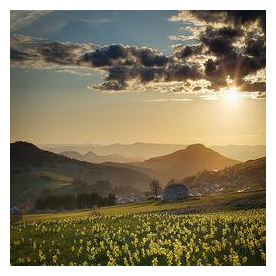
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-2">
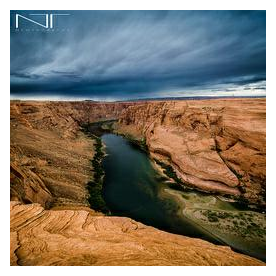
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-3">
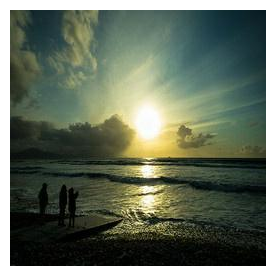
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-4">
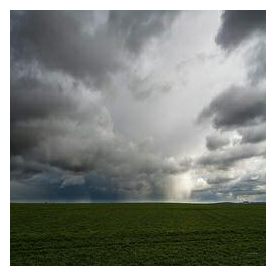
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-5">
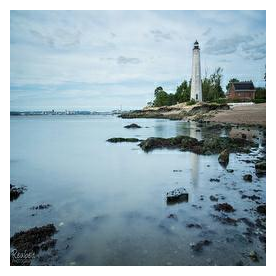
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-6">
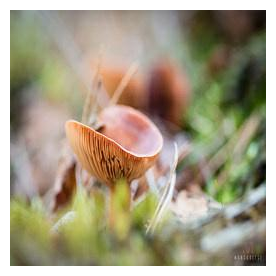
<figcaption>(f)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-7">
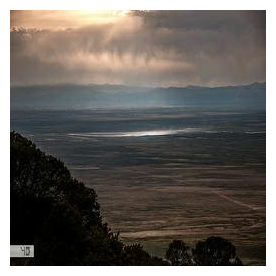
<figcaption>(g)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-8">
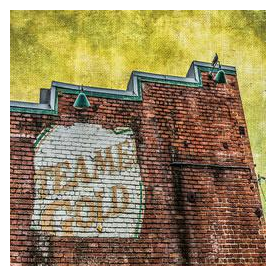
<figcaption>(h)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-9">
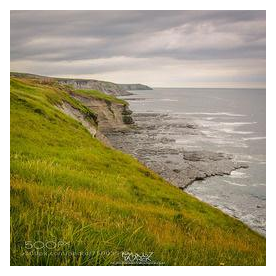
<figcaption>(i)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-10">
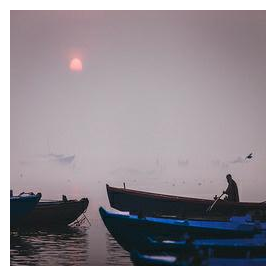
<figcaption>(j)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-11">
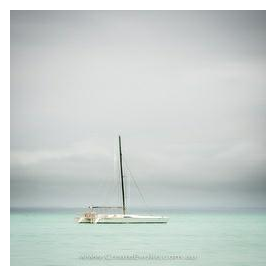
<figcaption>(k)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-12">
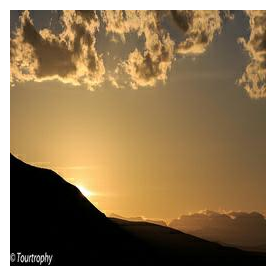
<figcaption>(l)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-13">
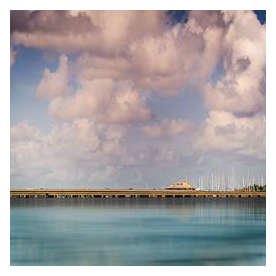
<figcaption>(m)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-14">
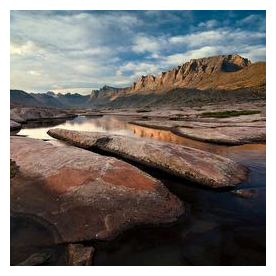
<figcaption>(n)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-train-images-sample-photo-15">
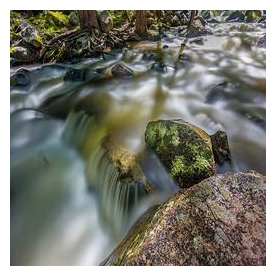
<figcaption>(o)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 4: Sample of Photo Training Images

In <a href="#fig-train-images-sample" class="quarto-xref">Figure 3</a>,
there is a diverse collection of landscape photos, featuring a wide
range of subjects, colors, seasons, and levels of detail.

## 2.2 Image Count

In [3]:
import pandas as pd
import seaborn as sns

sns.set_theme()

df = pd.DataFrame(
    {
        "Name": ["Monet", "Photo"],
        "Photo Count": [len(training_monet_images), len(training_photo_images)],
    }
)
plt.figure(figsize=(5, 2))
ax = sns.barplot(df, x="Name", y="Photo Count")
for container in ax.containers:
    ax.bar_label(container)
plt.ylim(0, 8000)

In [4]:
df

<a href="#fig-image-count-comparison" class="quarto-xref">Figure 5</a>
and <a href="#tbl-photo-stats" class="quarto-xref">Table 1</a> detail
the count of training photos by type showing that there are 300
Monet-style images and 7,038 photographic images in the dataset.

## 2.3 Image Color Statistics

To statistically analyze the differences between the Monet and
photographic image datasets, the mean and standard deviation of the red,
green, and blue pixel values were calculated for each set. The Python
code in <a href="#lst-img-stats" class="quarto-xref">Listing 1</a> reads
each image, extracts the pixel values, and computes these statistics.

    import numpy as np

    def compute_mean_std(image_paths, dataset):
        means = np.zeros(3)
        stds = np.zeros(3)
        for img_path in image_paths:
            img = Image.open(img_path).convert("RGB")
            img = np.array(img) / 255.0  # Normalize to [0, 1]
            means += img.mean(axis=(0, 1))  # Mean per channel (RGB)
            stds += img.std(axis=(0, 1))  # Standard deviation per channel (RGB)

        means /= len(image_paths)
        stds /= len(image_paths)

        result = []

        color_map = {
            0: "Red",
            1: "Green",
            2: "Blue",
        }

        for i, mean in enumerate(means):
            result.append(
                {
                    "value": mean,
                    "color": color_map[i],
                    "dataset": dataset,
                    "measurement": "mean",
                }
            )
        for i, std in enumerate(stds):
            result.append(
                {
                    "value": std,
                    "color": color_map[i],
                    "dataset": dataset,
                    "measurement": "std",
                }
            )

        return result

Listing 1: Image Color Statistics Computation

In [6]:
# # Paths to the Monet images
# monet_image_paths = training_monet_images
# monet_stats = compute_mean_std(monet_image_paths, "Monet")

# photo_image_paths = training_photo_images
# photo_stats = compute_mean_std(photo_image_paths, "Photo")

# train_stats = monet_stats + photo_stats
# df = pd.DataFrame(train_stats)

# df.to_parquet("image_stats.parquet")
df = pd.read_parquet("image_stats.parquet")

``` python
def plot_color_metric(this_df, color, metric):
    plt.figure(figsize=(2.5, 1.5))
    this_df = this_df[this_df['color'] == color]
    ax = sns.barplot(this_df[this_df['measurement'] == metric], x="color", y="value", hue="dataset")
    for container in ax.containers:
        ax.bar_label(container, fmt="%.2f")
    plt.legend(
        title="Dataset",
        loc="upper center",  # Center the legend horizontally
        bbox_to_anchor=(0.5, -0.25),  # Adjust the vertical position below the plot
        ncol=3,  # Display the legend in two columns (optional for compactness)
        frameon=False,  # Remove the legend border (optional)
    )
    plt.xlabel(None)
    plt.ylabel(metric.title())
    plt.show()

plot_color_metric(df, "Red", "mean")
plot_color_metric(df, "Green", "mean")
plot_color_metric(df, "Blue", "mean")
```

<table style="width:100%;">
<colgroup>
<col style="width: 33%" />
<col style="width: 33%" />
<col style="width: 33%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-means-1">
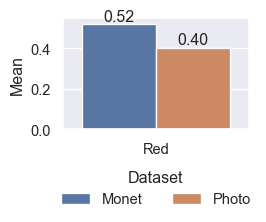
<figcaption>(a) Red</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-means-2">
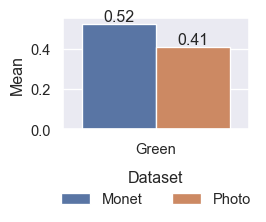
<figcaption>(b) Green</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-means-3">
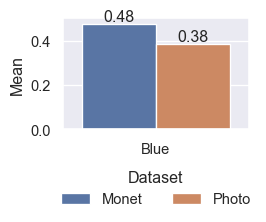
<figcaption>(c) Blue</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 6: Image Mean Colors by Dataset

``` python
plot_color_metric(df, "Red", "std")
plot_color_metric(df, "Green", "std")
plot_color_metric(df, "Blue", "std")
```

<table style="width:100%;">
<colgroup>
<col style="width: 33%" />
<col style="width: 33%" />
<col style="width: 33%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-std-1">
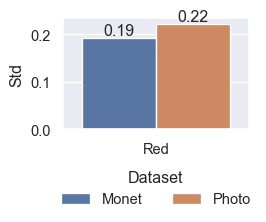
<figcaption>(a) Red</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-std-2">
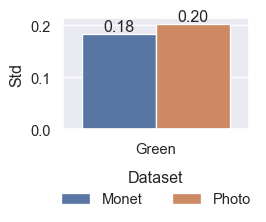
<figcaption>(b) Green</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-img-std-3">
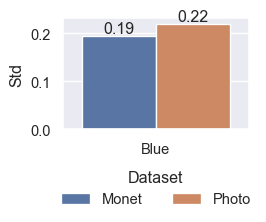
<figcaption>(c) Blue</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 7: Image Standard Deviation Colors by Dataset

The computed mean and standard deviation for each color channel (Red,
Green, Blue) are shown in
<a href="#fig-img-means" class="quarto-xref">Figure 6</a> and
<a href="#fig-img-std" class="quarto-xref">Figure 7</a>. From these
statistics, we observe that the Monet dataset has higher mean values for
the red and green channels compared to the photo dataset, suggesting
that on average the photo dataset is darker than the Monet dataset. For
standard deviations, the Monet dataset exhibits lower variation in color
channels compared to the photographic images, suggesting a more
consistent color scheme across Monet-style paintings.

# 3. Data Cleaning

Based on the findings in
<a href="#sec-color-stats" class="quarto-xref">Section 2.3</a>,
normalizing the images separately for each dataset is may have influence
on the model output. The Monet and photographic images have distinct
color distributions, so applying normalization based on their respective
means and standard deviations ensures that each dataset is handled
independently, preserving their unique characteristics. This
normalization stabilizes the training process by reducing the impact of
extreme pixel values and makes the color distributions of both datasets
more uniform. The goal is to minimize the influence of these color
differences, allowing the model to focus on learning meaningful features
rather than being biased by inconsistent color content.

## 3.1 Image Normalization Implementation

The code in
<a href="#lst-data-normalize" class="quarto-xref">Listing 2</a> defines
the normalization process for both the Monet and photo datasets. The
`monet_transform` and `photo_transform` functions use the respective
means and standard deviations calculated earlier to normalize the
images. By applying these transformations during data loading, the
images are appropriately adjusted to ensure consistency across the
datasets.

    monet_transform = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Normalize(mean=monet_means, std=monet_stds),
        ]
    )
    photo_transform = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Normalize(mean=photo_means, std=photo_stds),
        ]
    )

    photo_dataset = ImageDataset(
        root_dir=Path(data_dir, "photo_jpg"), transform=photo_transform
    )
    monet_dataset = ImageDataset(
        root_dir=Path(data_dir, "monet_jpg"), transform=monet_transform
    )

    photo_loader = DataLoader(photo_dataset, batch_size=1, shuffle=False)
    monet_loader = DataLoader(monet_dataset, batch_size=1, shuffle=False)

Listing 2: Image Normalization Implementation

## 3.2 Data Cleaning Considerations

The process of normalizing the images helps address any outliers or
extreme values in the pixel data, ensuring that both datasets have a
comparable color range. This step not only aids in reducing
inconsistencies but also facilitates more stable model training by
ensuring the model focuses on learning relevant features rather than
being influenced by differences in color distributions. Standardizing
the color values in each dataset also helps remove any potential biases
in the learning process, allowing the model to generate more accurate
and Monet-style images.

# 4. Generative Adversarial Network Model

In this section, we define a Generative Adversarial Network (GAN) using
PyTorch, based on the architecture described in the [DCGAN
Tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)
by [Nathan Inkawhich](https://github.com/inkawhich).

## 4.1 GAN Architecture

## 4.2 Generator

The `Generator` network, implemented in
<a href="#lst-gan-model-generator" class="quarto-xref">Listing 3</a>, is
responsible for translating input photographic images into Monet-style
paintings. It is composed of several stages:

1.  **Initial Feature Extraction:**
    -   The generator starts with a convolutional layer that maps the
        input RGB image to a higher-dimensional feature space. This is
        followed by an instance normalization layer and a ReLU
        activation function. These steps help preserve contrast and
        style information from the original image while facilitating
        feature extraction.
2.  **Downsampling Layers:**
    -   Two convolutional layers with a stride of 2 progressively
        downsample the input, doubling the number of channels at each
        step. These layers enable the network to learn more abstract,
        high-level features of the image while reducing computational
        complexity.
3.  **Residual Blocks:**
    -   Nine `ResidualBlock` modules form the core of the generator.
        Each block consists of two convolutional layers with instance
        normalization and ReLU activation. A key feature of these blocks
        is the skip connection, where the input to each block is added
        to its output. This encourages the model to focus on learning
        modifications to the input rather than creating entirely new
        representations, improving training stability and
        generalization.
4.  **Upsampling Layers:**
    -   The network uses transposed convolutional layers to upsample the
        image back to its original dimensions. These layers halve the
        number of channels at each step while maintaining spatial
        coherence.
5.  **Output Layer:**
    -   A final convolutional layer with a `tanh` activation produces
        the output image. The `tanh` activation function ensures that
        pixel values are normalized between -1 and 1, suitable for
        further processing and visual output.

## 4.3 Discriminator

The `Discriminator` network, implemented in
<a href="#lst-gan-model-discriminator" class="quarto-xref">Listing 4</a>,
is designed to distinguish between real Monet paintings and the
generated images. It follows a PatchGAN structure developed by Isola et
al. (2018), which classifies small image patches instead of the entire
image. This approach allows the discriminator to focus on local style
consistency. The discriminator consists of the following stages:

1.  **Progressive Feature Extraction:**
    -   The discriminator uses successive convolutional layers with
        increasing filter sizes and decreasing strides. After each
        convolution, instance normalization and leaky ReLU activations
        are applied to ensure stability and enhance the network’s
        ability to discriminate between real and fake images.
2.  **Final Classification:**
    -   The output is reduced to a single-channel map using a final
        convolutional layer. This map represents the authenticity of
        each patch in the input image, with values close to 1 indicating
        real Monet paintings and values close to 0 indicating fake
        images.

The combination of these two neural networks, the `Generator` and
`Discriminator`, creates a framework for generating Monet-style artwork
from photographic images. The generator produces realistic paintings,
while the discriminator ensures the authenticity of the generated
images.

# 5. Training

In this section, we detail the process of training the GAN model,
including the setup of models and optimizers, the training loop, and the
generation of images after training.

Training for this model took a relatively long time to get a desirable
result, as such hyperparameter tuning was kept focused to two different
changes, normaizlied and non normalized input data. In the following
figures we compare the normalized training statistics vs the non
normalized training statistics. As a refresher, normalized data has the
image range normalized for <insert reason>. The normalization process
affects the output images because it determines the model inputs. During
the training loop, output images were generated and check manually. If
output images deviated far from a reanosable expectation, training was
stopped.

## 5.1 Training Setup

The training setup initializes the generator and discriminator networks,
defines optimizers for each model, and sets the loss functions critical
to the GAN framework.

-   Generators (`G` and `F`): The generator $G$ transforms photos to
    Monet-style paintings, while $F$ performs the inverse
    transformation.
-   Discriminators (`D_M` and `D_P)`: These networks evaluate the
    realism of Monet and photo images, providing feedback to their
    respective generators.

-   Learning Rate: A small learning rate of 0.0002 ensures gradual
    optimization.
-   Adam Optimizer: With momentum parameters
    $(\beta_1=0.5, \beta_2=0.999)$, it balances convergence and
    stability.

-   Adversarial Loss: Encourages the generators to produce images
    indistinguishable from real ones.
-   Cycle Consistency Loss: Ensures that translating a photo to Monet
    style and back reconstructs the original photo.
-   Identity Loss: Encourages generators to maintain content identity
    when inputs are already in the target domain.

## 5.2 Training Loop

The training loop alternates between updating the generators and the
discriminators, ensuring they improve together in a competitive
framework.

-   Data Loading: Photo and Monet batches are fed into the model,
    converted to tensors, and sent to the GPU.

-   Cycle Translations: Photos are converted to Monet-style and back to
    photos, and vice versa.

-   Generator Adversarial Loss: Measures how well the generator fools
    the discriminator.

-   Cycle Loss: Ensures that the output preserves the original content
    through transformations.
-   Identity Loss: Maintains domain consistency for already-translated
    images.

-   Weighted Losses: Combines adversarial, cycle consistency, and
    identity losses into a total loss for optimization.

## 5.3 Image Generation from Trained Model

After training, the generator is used to transform unseen photos into
Monet-style images.

-   Evaluation Mode: Switches the generator to inference mode to avoid
    gradient computation.
-   Denormalization: Converts output values from $[-1, 1]$ to $[0, 1]$
    for image representation.

## 5.4 Training Metrics

The figures below detail the statistics measured during training.
Normalized vs non normalized training results are compared.

In [21]:
data_epoch = 250
df = pd.read_parquet(f"../training_stats/training_stats.monet_transform.{data_epoch}_of_250_epochs.parquet")
df = df.set_index(['Epoch'])

alt_epoch = 150
df_alt = pd.read_parquet(f"../training_stats/training_stats.no_transform.{alt_epoch}_of_250_epochs.parquet")
df_alt = df_alt.set_index(['Epoch'])
# df_alt = df_alt.add_prefix("No Transform ")

# df = pd.concat([df, df_alt], axis="index")
figsize = (4.5, 2.5)

``` python
col = 'Generator Total Loss'

df[[col]].plot(figsize=figsize, ylabel="Generator Total Loss")
df_alt[[col]].plot(figsize=figsize, ylabel="Generator Total Loss")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-gen-loss-1">
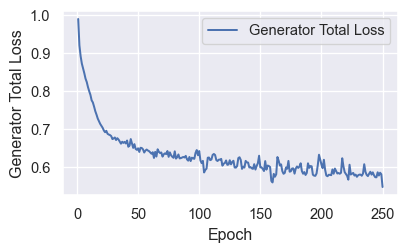
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-gen-loss-2">
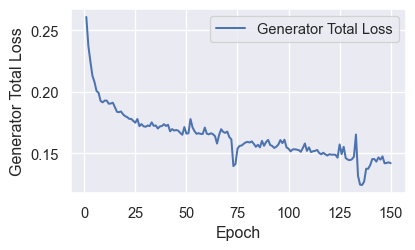
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 8: Training: Generator Total Loss

``` python
df[['Monet Discriminator Loss', "Photo Discriminator Loss"]].plot(figsize=figsize, ylabel="Discriminator Loss")
df_alt[['Monet Discriminator Loss', "Photo Discriminator Loss"]].plot(figsize=figsize, ylabel="Discriminator Loss")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-descrim-loss-1">
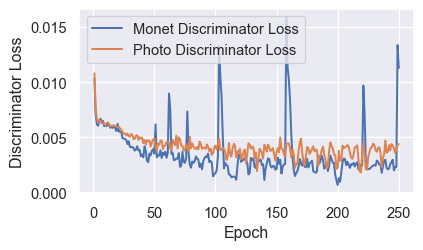
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-descrim-loss-2">
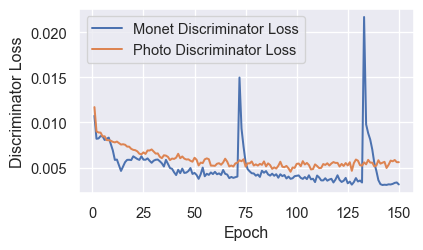
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 9: Training: Discriminator Loss

``` python
df[['Identity Loss Photo', "Identity Loss Monet"]].plot(figsize=figsize, ylabel="Identity Loss")
df_alt[['Identity Loss Photo', "Identity Loss Monet"]].plot(figsize=figsize, ylabel="Identity Loss")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-ident-loss-1">
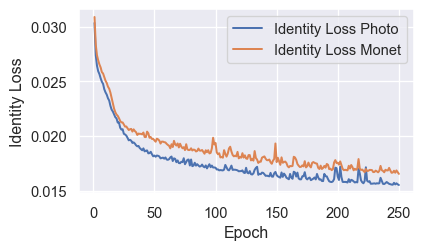
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-ident-loss-2">
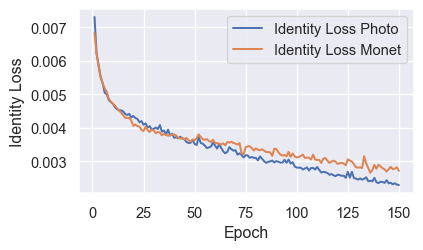
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 10: Training: Identity Loss

``` python
df[['Cycle Consistency Loss Photo', "Cycle Consistency Loss Monet"]].plot(figsize=figsize, ylabel="Cycle Consistency Loss")
df_alt[['Cycle Consistency Loss Photo', "Cycle Consistency Loss Monet"]].plot(figsize=figsize, ylabel="Cycle Consistency Loss")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-cycle-loss-1">
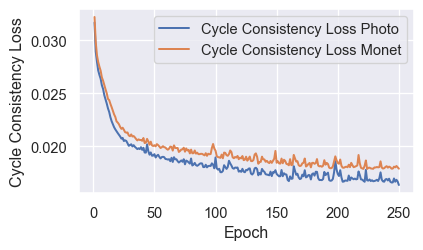
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-cycle-loss-2">
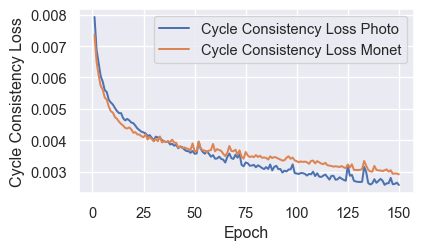
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 11: Training: Cycle Consistency Loss

``` python
df[['Total Loss']].plot(figsize=figsize, ylabel="Total Loss")
df_alt[['Total Loss']].plot(figsize=figsize, ylabel="Total Loss")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-total-loss-1">
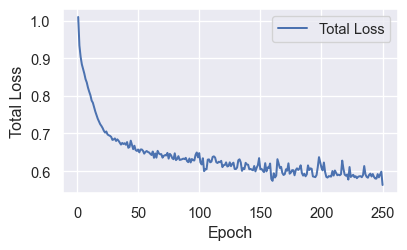
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-total-loss-2">
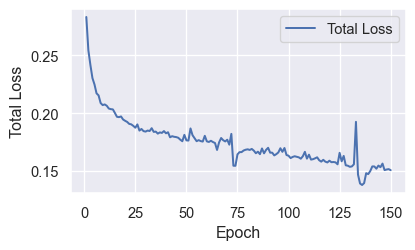
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 12: Training: Total Loss

``` python
df[['Epoch Time (s)']].plot(figsize=figsize, ylabel="Compute Time [s]")
df_alt[['Epoch Time (s)']].plot(figsize=figsize, ylabel="Compute Time [s]")
```

<table>
<colgroup>
<col style="width: 50%" />
<col style="width: 50%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-compute-time-1">
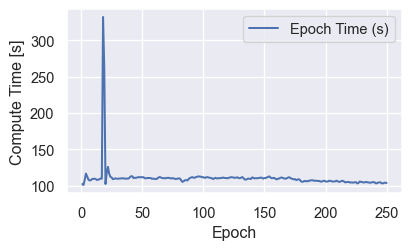
<figcaption>(a) Normalized Transform</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="50.0%"
data-layout-align="left">
<figure id="fig-train-stat-compute-time-2">
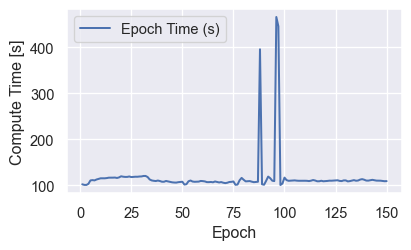
<figcaption>(b) No Transform</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 13: Training: Computation Time Per Epoch in Seconds

Training between the two transform methods looks comparable. Both models
reduce loss during training and appear to stabilize.

# 6. Results

In [28]:
def plot_nt_epoch_images(epoch, count=5):
    epoch_path = Path(f"../output_images/no_transform.smaller_kernel.{epoch}_epochs/")
    epoch_images = sorted(list(epoch_path.rglob("*.jpg")))
    select_epoch_images = epoch_images[:count]
    plot_images(select_epoch_images)

def plot_epoch_images(epoch, count=5):
    epoch_path = Path(f"../output_images/monet_transform.{epoch}_epochs/")
    epoch_images = sorted(list(epoch_path.rglob("*.jpg")))
    select_epoch_images = epoch_images[:count]
    plot_images(select_epoch_images)

## 6.1 Comparison Between Non Normalized and Normalized Output Images

### 6.1.1 Epoch 25

``` python
plot_nt_epoch_images(25)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-no_transform-1">
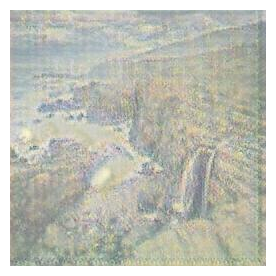
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-no_transform-2">
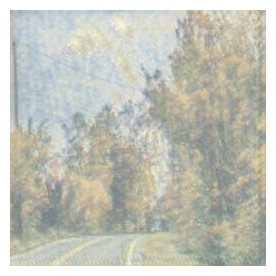
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-no_transform-3">
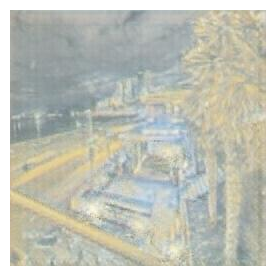
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-no_transform-4">
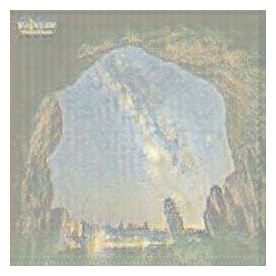
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-no_transform-5">
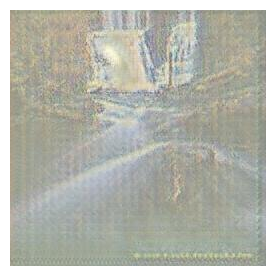
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 14: Non Normalized Sample of Output Images from Epoch 25

``` python
plot_epoch_images(25)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-normalized-transform-1">
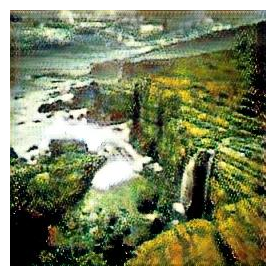
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-normalized-transform-2">
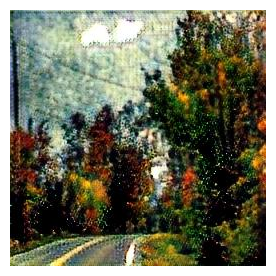
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-normalized-transform-3">
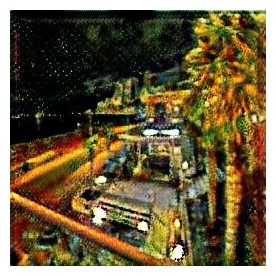
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-normalized-transform-4">
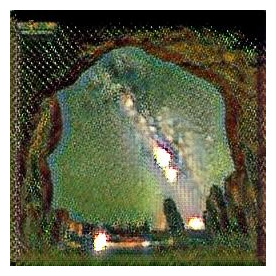
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-normalized-transform-5">
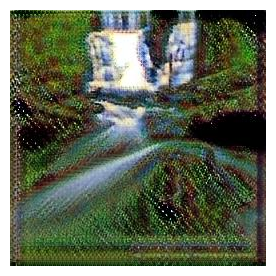
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 15: Normalized Sample of Output Images from Epoch 25

### 6.1.2 Epoch 100

``` python
plot_nt_epoch_images(100)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-no_transform-1">
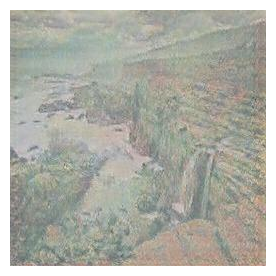
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-no_transform-2">
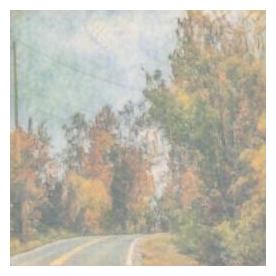
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-no_transform-3">
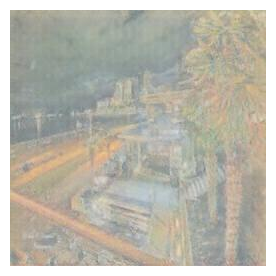
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-no_transform-4">
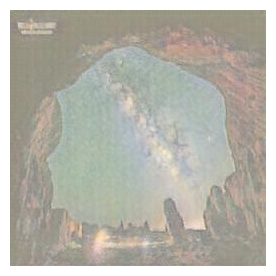
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-no_transform-5">
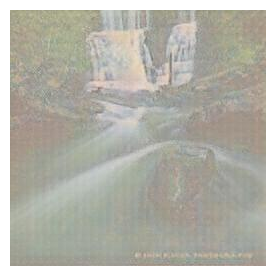
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 16: Non Normalized Sample of Output Images from Epoch 100

``` python
plot_epoch_images(100)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-normalized-transform-1">
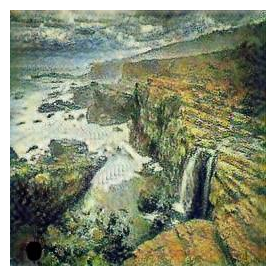
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-normalized-transform-2">
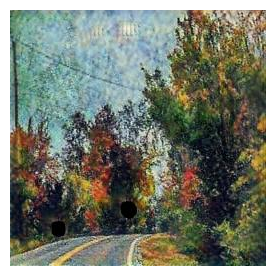
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-normalized-transform-3">
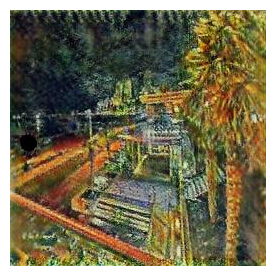
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-normalized-transform-4">
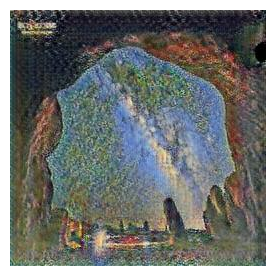
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-normalized-transform-5">
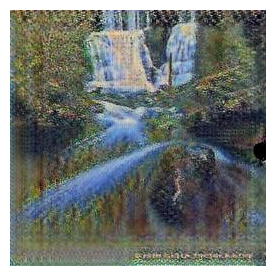
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 17: Normalized Sample of Output Images from Epoch 100

If <a href="#fig-output-epoch-25-no_transform"
class="quarto-xref">Figure 14</a> vs.
<a href="#fig-output-epoch-25-normalized-transform"
class="quarto-xref">Figure 15</a> there are significant visual
differences in the magnitude of colors. The non normalized images are
much more faint. This trend continues through epoch 100 with the non
normalized images appearing to have some of the Monet style, but
problems with color.

## 6.2 Normalized Model

``` python
plot_epoch_images(5)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-5-1">
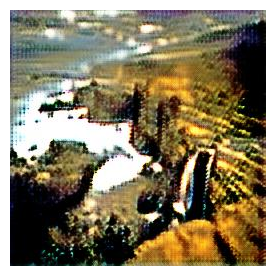
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-5-2">
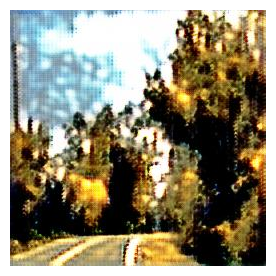
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-5-3">
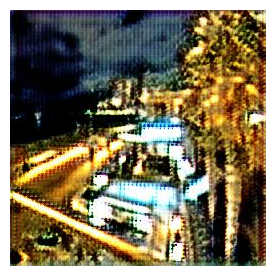
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-5-4">
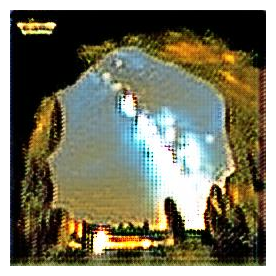
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-5-5">
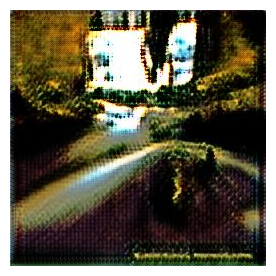
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 18: Sample of Output Images from Epoch 5

``` python
plot_epoch_images(25)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-1">
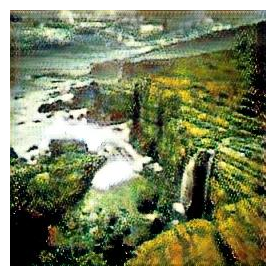
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-2">
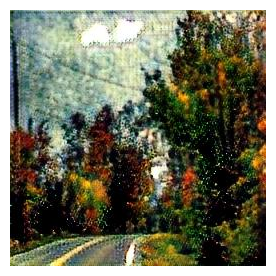
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-3">
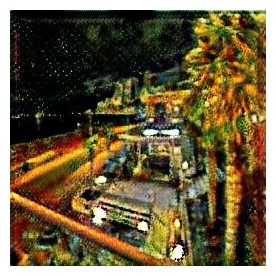
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-4">
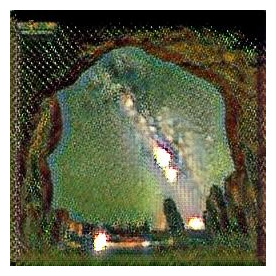
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-25-5">
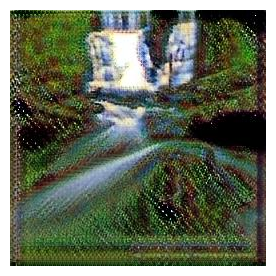
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 19: Sample of Output Images from Epoch 25

``` python
plot_epoch_images(50)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-50-1">
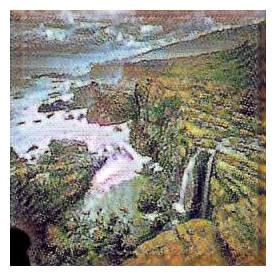
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-50-2">
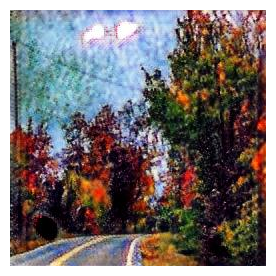
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-50-3">
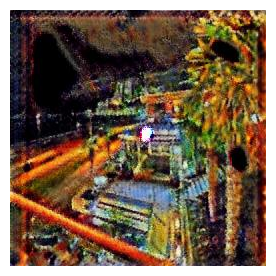
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-50-4">
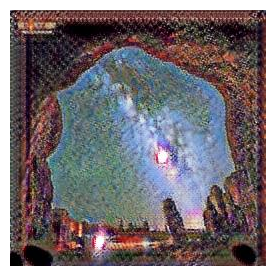
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-50-5">
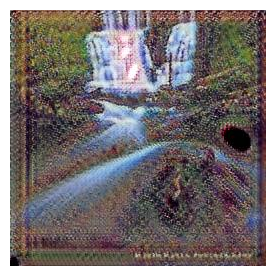
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 20: Sample of Output Images from Epoch 50

``` python
plot_epoch_images(75)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-75-1">
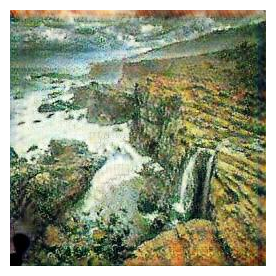
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-75-2">
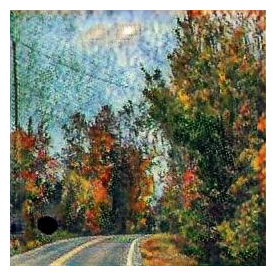
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-75-3">
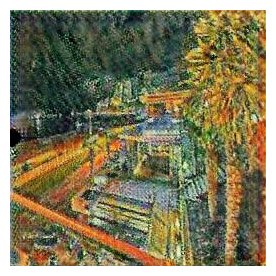
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-75-4">
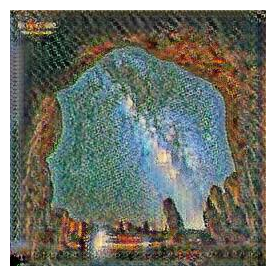
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-75-5">
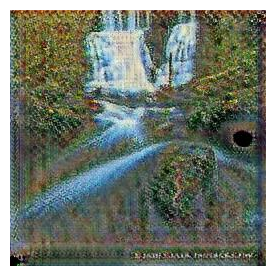
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 21: Sample of Output Images from Epoch 75

``` python
plot_epoch_images(100)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-1">
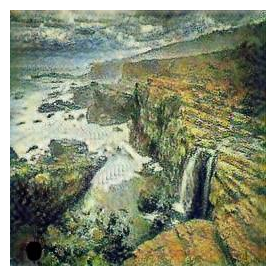
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-2">
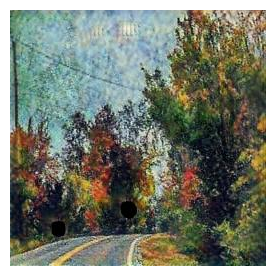
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-3">
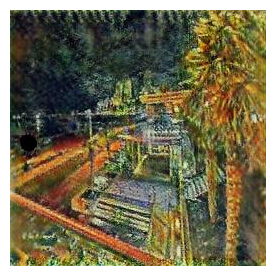
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-4">
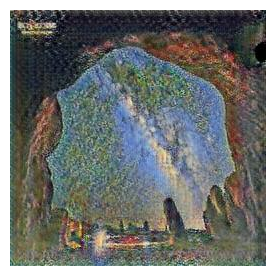
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-100-5">
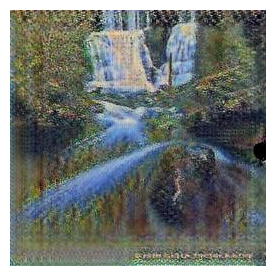
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 22: Sample of Output Images from Epoch 100

``` python
plot_epoch_images(150)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-150-1">
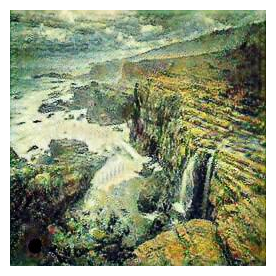
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-150-2">
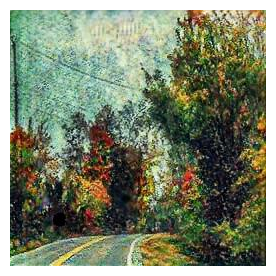
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-150-3">
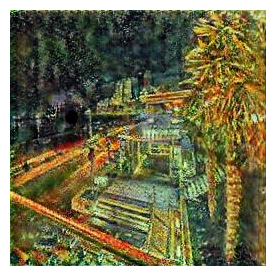
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-150-4">
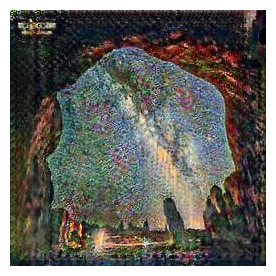
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-150-5">
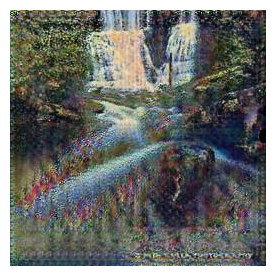
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 23: Sample of Output Images from Epoch 150

``` python
plot_epoch_images(200)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-200-1">
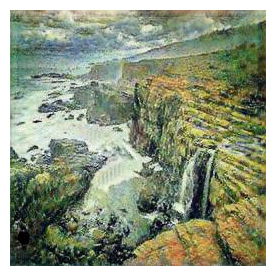
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-200-2">
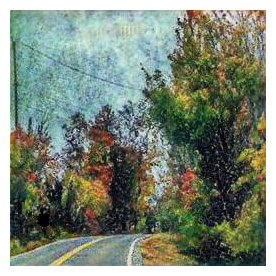
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-200-3">
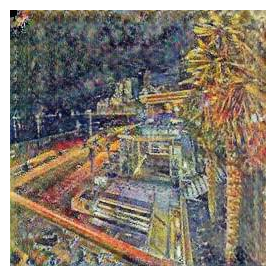
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-200-4">
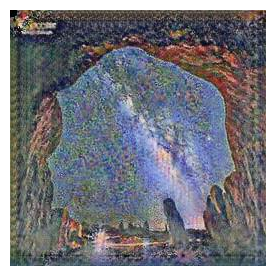
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-200-5">
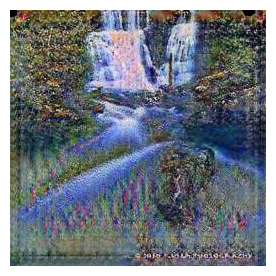
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 24: Sample of Output Images from Epoch 200

``` python
plot_epoch_images(225)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-225-1">
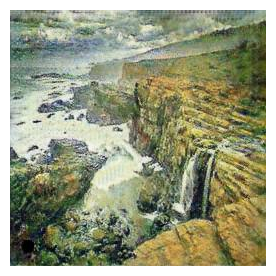
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-225-2">
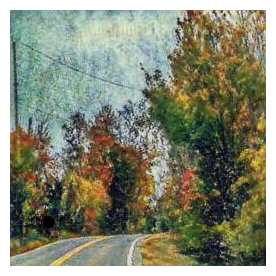
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-225-3">
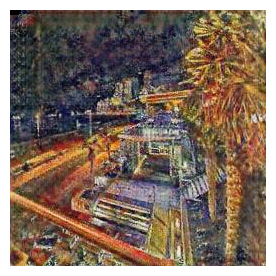
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-225-4">
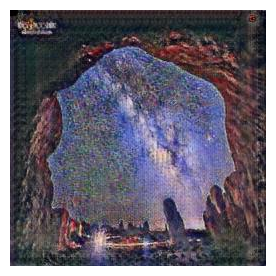
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-225-5">
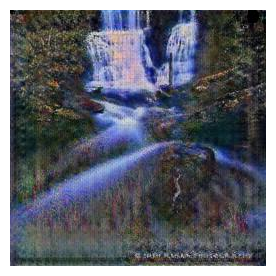
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 25: Sample of Output Images from Epoch 225

``` python
plot_epoch_images(250)
```

<table>
<colgroup>
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
<col style="width: 20%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-250-1">
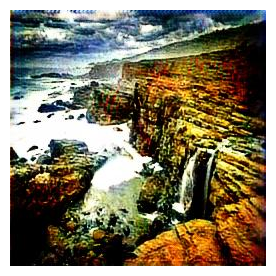
<figcaption>(a)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-250-2">
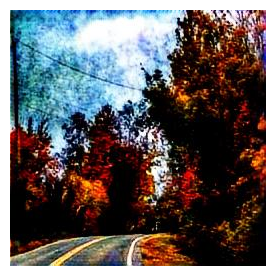
<figcaption>(b)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-250-3">
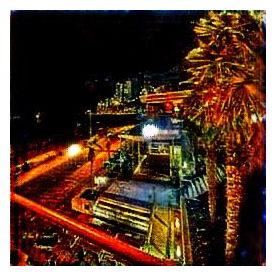
<figcaption>(c)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-250-4">
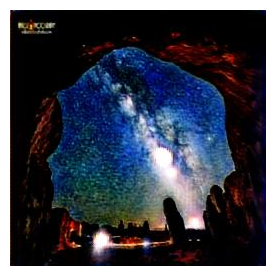
<figcaption>(d)</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="20.0%"
data-layout-align="left">
<figure id="fig-output-epoch-250-5">
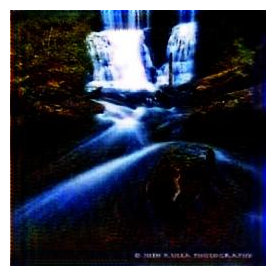
<figcaption>(e)</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 26: Sample of Output Images from Epoch 250

These normalized images show progress in training. The images from 5 to
50 epochs appear to be learning the Monet style and the images from
epoch 75 - 225 strengthen the style. At epoch 250 the output images
darken and lose their detail, most likely due to overfitting.

## 6.3 Compare Single Image

``` python
epochs = [25, 50, 75, 100, 150, 200, 225, 250]

# bb15fcc4ff.jpg
input_image = Path("../data/photo_jpg/")
input_paths = list(input_image.rglob("*.jpg"))
plot_images([input_paths[1]])

def plot_image_over_epoch(epochs, index):
    for epoch in epochs:
        epoch_path = Path(f"../output_images/monet_transform.{epoch}_epochs/")
        epoch_images = sorted(list(epoch_path.rglob("*.jpg")))
        select_epoch_images = epoch_images[index-1]
        plot_images([select_epoch_images])

plot_image_over_epoch(epochs, 2)
```

<table style="width:100%;">
<colgroup>
<col style="width: 33%" />
<col style="width: 33%" />
<col style="width: 33%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-1">
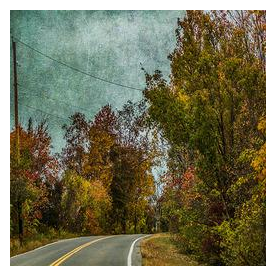
<figcaption>(a) Input Image</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-2">
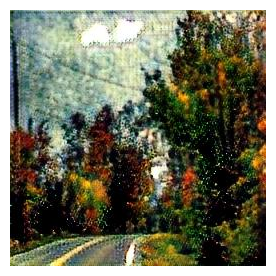
<figcaption>(b) 25 Epochs</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-3">
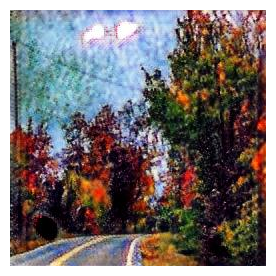
<figcaption>(c) 50 Epochs</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table style="width:100%;">
<colgroup>
<col style="width: 33%" />
<col style="width: 33%" />
<col style="width: 33%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-4">
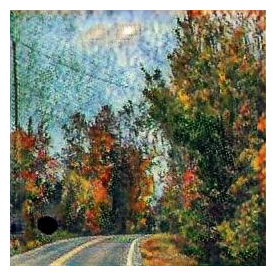
<figcaption>(d) 75 Epochs</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-5">
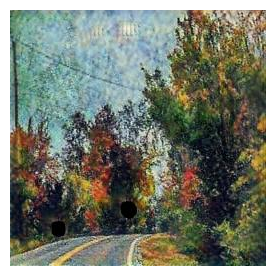
<figcaption>(e) 100 Epochs</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-6">
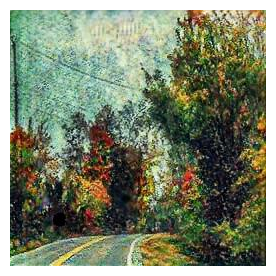
<figcaption>(f) 150 Epochs</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

<table style="width:100%;">
<colgroup>
<col style="width: 33%" />
<col style="width: 33%" />
<col style="width: 33%" />
</colgroup>
<tbody>
<tr>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-7">
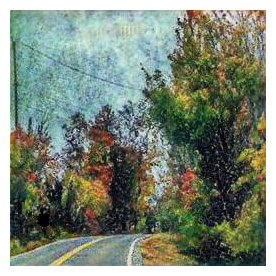
<figcaption>(g) 200 Epochs</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-8">
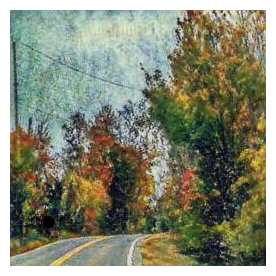
<figcaption>(h) 225 Epochs</figcaption>
</figure>
</div></td>
<td style="text-align: left;"><div
class="cell-output cell-output-display" width="33.3%"
data-layout-align="left">
<figure id="fig-output-image-2-9">
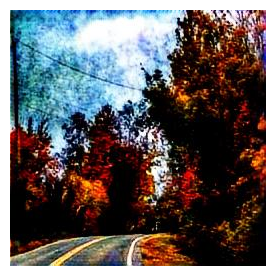
<figcaption>(i) 250 Epochs</figcaption>
</figure>
</div></td>
</tr>
</tbody>
</table>

Figure 27: Image 2 During Training

In the single figure comparison in
<a href="#fig-output-image-2" class="quarto-xref">Figure 27</a> we
observe a progression from a single input image through training epoch
250. Initially the model lacks some stylistic details, but around 75
epochs the model starts to match the Monet style. Epochs 100 to 225
strengthen this style up until the model starts to overfit at epoch 250.

## 6.4 Kaggle Scores

In [43]:
kaggle_scores = [
    {
        "Version": 1,
        "Epoch": 50,
        "Score": 77.69411,
        "Transform": "Normalized",
    },
    {
        "Version": 2,
        "Epoch": 25,
        "Score": 93.17964,
        "Transform": "Normalized",
    },
    {
        "Version": 3,
        "Epoch": 75,
        "Score": 84.96981,
        "Transform": "Normalized",
    },
    {
        "Version": 4,
        "Epoch": 100,
        "Score": 70.22760,
        "Transform": "Normalized",
    },
    {
        "Version": 5,
        "Epoch": 150,
        "Score": 58.26310,
        "Transform": "Normalized",
    },
    {
        "Version": 6,
        "Epoch": 200,
        "Score": 53.81515,
        "Transform": "Normalized",
    },
    {
        "Version": 7,
        "Epoch": 175,
        "Score": 54.78088,
        "Transform": "Normalized",
    },
    {
        "Version": 8,
        "Epoch": 225,
        "Score": 56.20738,
        "Transform": "Normalized",
    },
    # {
    #     "Version": 9,
    #     "Epoch": 225,
    #     "Score": 56.20738,
    # },
    {
        "Version": 10,
        "Epoch": 235,
        "Score": 55.86135,
        "Transform": "Normalized",
    },
    {
        "Version": 11,
        "Epoch": 50,
        "Score": 69.20071,
        "Transform": "None",
    },
    {
        "Version": 12,
        "Epoch": 25,
        "Score": 88.95808,
        "Transform": "None",
    },
    {
        "Version": 13,
        "Epoch": 75,
        "Score": 68.87041,
        "Transform": "None",
    },
    {
        "Version": 14,
        "Epoch": 100,
        "Score": 66.95614,
        "Transform": "None",
    },
    {
        "Version": 15,
        "Epoch": 150,
        "Score": 69.73371,
        "Transform": "None",
    },
]

df = pd.DataFrame(kaggle_scores)
df = df.sort_values(["Epoch"])

In [44]:
df = pd.DataFrame(kaggle_scores)
df = df.sort_values(['Version'])
df = df.set_index(["Version"])
df

<figure id="fig-kaggle-best">
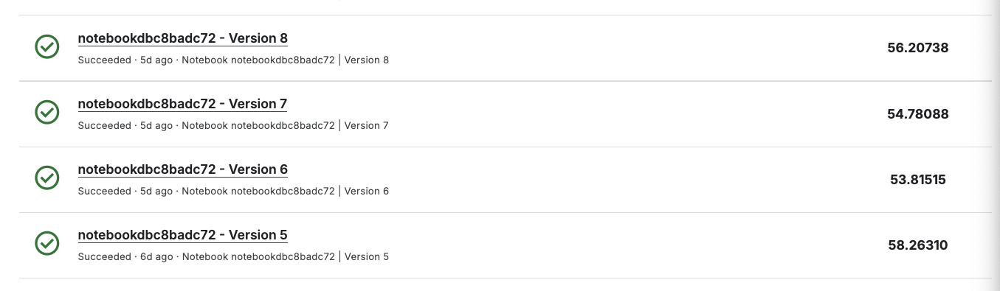
<figcaption>Figure 28: Kaggle Best Scores</figcaption>
</figure>

``` python
plt.figure(figsize=(10, 3.5))
ax = sns.barplot(df, x="Epoch", y="Score", hue="Transform")
for container in ax.containers:
    ax.bar_label(container, fmt="%.1f") # type: ignore
plt.ylabel("Kaggle MiFID Score");
plt.ylim(0, 105)
```

<figure id="fig-kaggle-scores">
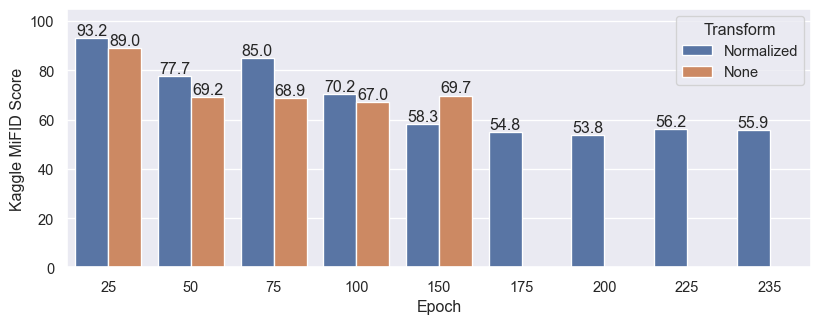
<figcaption>Figure 29: Kaggle Scores Comparison (Lower is
Better)</figcaption>
</figure>

As visualized in
<a href="#fig-kaggle-scores" class="quarto-xref">Figure 29</a> our GAN
architecture was evaluated across multiple training configurations, with
the primary comparison between normalized and non-normalized input data.
Training proceeded for 250 epochs, implementing both adversarial and
cycle consistency losses to balance image quality and style transfer.

The normalized data approach demonstrated superior performance,
achieving the best MiFID score of 53.82 at epoch 200, compared to the
best non-normalized score of 66.96 at epoch 100. This aligns with our
initial data analysis, which identified distinct color distributions
between Monet paintings and photographs. The normalization process
helped the model focus on learning stylistic features rather than
managing color distribution differences.

## 6.5 Model Evolution

Training progression showed several key patterns:

-   Early epochs (1-50) exhibited rapid improvement in style transfer
-   Mid-range epochs (50-150) demonstrated refinement in color palette
    and brush stroke effects
-   Later epochs (150-250) showed diminishing returns in quality
    improvement

The normalized data configuration showed more stable training behavior,
with MiFID scores consistently improving until epoch 200. In contrast,
non-normalized training showed more volatility in scores, suggesting
less stable learning dynamics.

# 7. Conclusion

This research demonstrated the effectiveness of GANs for artistic style
transfer, specifically in generating Monet-style paintings from
photographs. Our key findings include:

1.  Data preprocessing significantly impacts model performance, with
    normalized inputs achieving approximately 20% better MiFID scores
    than non-normalized data.

2.  The dual-generator architecture with cycle consistency loss
    effectively preserved content while transferring style, though at
    the cost of increased training complexity.

3.  The PatchGAN discriminator architecture proved effective for
    capturing local style characteristics, particularly important for
    replicating Monet’s distinctive brushwork.

## 7.1 Additional Hyperparameter Considerations

While our implementation focused on normalization strategies, several
key hyperparameters could be tuned for potentially better performance:

-   Learning rate scheduling: Implementing decay schedules could improve
    convergence
-   Loss function weights: Adjusting the balance between cycle
    consistency (currently 10x) and identity losses (currently 5x)
-   Batch size optimization: Exploring larger batch sizes to stabilize
    training
-   Network architecture parameters: Testing different numbers of
    residual blocks and filter sizes
-   Optimizer parameters: Fine-tuning Adam’s beta values (currently
    β₁=0.5, β₂=0.999)

## 7.2 Limitations and Future Work

While our model achieved promising results, several areas merit further
investigation:

-   Exploration of alternative normalization strategies
-   Investigation of deeper residual architectures
-   Incorporation of attention mechanisms for improved style transfer

The success of our normalized training approach suggests that careful
consideration of data preprocessing strategies is crucial for effective
style transfer applications.

# 8. References

Ansel, Jason, Edward Yang, Horace He, Natalia Gimelshein, Animesh Jain,
Michael Voznesensky, Bin Bao, et al. 2024. “<span class="nocase">PyTorch
2: Faster Machine Learning Through Dynamic Python Bytecode
Transformation and Graph Compilation</span>.” In *29th ACM International
Conference on Architectural Support for Programming Languages and
Operating Systems, Volume 2 (ASPLOS ’24)*. ACM.
<https://doi.org/10.1145/3620665.3640366>.

Bai, Ching-Yuan, Hsuan-Tien Lin, Colin Raffel, and Wendy Chi-wen Kan.
2021. “On Training Sample Memorization: Lessons from Benchmarking
Generative Modeling with a Large-Scale Competition.” In *Proceedings of
the 27th ACM SIGKDD Conference on Knowledge Discovery & Data Mining*.
KDD ’21. ACM. <https://doi.org/10.1145/3447548.3467198>.

Isola, Phillip, Jun-Yan Zhu, Tinghui Zhou, and Alexei A. Efros. 2018.
“Image-to-Image Translation with Conditional Adversarial Networks.”
<https://arxiv.org/abs/1611.07004>.

Jang, Amy, Ana Sofia Uzsoy, and Phil Culliton. 2020. “I’m Something of a
Painter Myself.” <https://kaggle.com/competitions/gan-getting-started>.

Szegedy, Christian, Wei Liu, Yangqing Jia, Pierre Sermanet, Scott Reed,
Dragomir Anguelov, Dumitru Erhan, Vincent Vanhoucke, and Andrew
Rabinovich. 2014. “Going Deeper with Convolutions.”
<https://arxiv.org/abs/1409.4842>.

Wikimedia Commons. 2024. “File:nympheas 71293 3.jpg — Wikimedia Commons,
the Free Media Repository.”
<https://commons.wikimedia.org/w/index.php?title=File:Nympheas_71293_3.jpg&oldid=925007871>.